In [21]:
import torch
from torchvision import datasets, transforms, utils
from torchvision.transforms.functional import to_pil_image
import torch.optim as optim
import torch.nn.functional as F
import torch.nn as nn

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
#from matplotlib.ticker import ScalarFormatter
%matplotlib inline

#My helpers
import helpers

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

from torchcam.cams import GradCAM
from torchcam.utils import overlay_mask

# My stuff
from gradcam.utils import deterministic_testloader

## Pre-Trained VGG-16 on Imagenette

A pretrained VGG-16 was finetuned for Imagenette. Exactly the same architecture as in the paper was used, except the last layer has a output of 10 (10 Imagenette classes) instead of 1000 (Imagenet).  
Results:  

"model_path": "trained_imgnette_models/run8_vgg_100ep_ft.pt",  
"was_it_pretrained": true,  
"training_accuracy": "0.99",  
"validation_accuracy": "0.98",  
"test_top1_accuracy": "0.97",  
"test_top5_accuracy": "1.00",  
"batch_size": 64,  
"epochs_specified": 100,  
"epochs_trained": 1,  
"which_optimizer_used": "SGD with a lr of 0.001 and momentum 0.9",  
"criterion_used": "CrossEntropyLoss",  
"time_used_for_training": "23m 49s"  

## Pruning Results

Only *Convolutional Layers* were then pruned according to a certain method, for different compression levels (2, 4, 8, ...). The table below shows the results.

In [2]:
df = pd.read_csv('pruning_results/results_02-05-2021_14-49-20.csv')
df[['pruning_method', 'sparsity', 'training_accuracy', 'validation_accuracy', 'test_top1_accuracy', 'test_top5_accuracy']]

,pruning_method,sparsity,training_accuracy,validation_accuracy,test_top1_accuracy,test_top5_accuracy
0,local_magnitude_unstructured,2,0.988383,0.984000,0.972857,0.998929
1,local_magnitude_unstructured,4,0.982469,0.973333,0.959286,0.998214
2,local_magnitude_unstructured,8,0.976133,0.958222,0.941071,0.997500
3,local_magnitude_unstructured,16,0.970747,0.945778,0.933929,0.997143
4,local_magnitude_unstructured,32,0.944873,0.912889,0.900714,0.993929
5,local_magnitude_unstructured,64,0.913402,0.896000,0.872500,0.992500


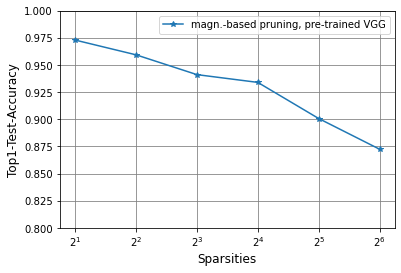

In [27]:
lmu = df[df['pruning_method'] == 'local_magnitude_unstructured']
#lru = df[df['pruning_method'] == 'local_random_unstructured']
plt.rcParams['axes.facecolor'] = 'white'
# plt.title('Local Magnitude VS Local Random Pruning', size=15)
plt.plot(lmu['sparsity'], lmu['test_top1_accuracy'], marker = '*')
#plt.plot(lru['sparsity'], lru['test_top1_accuracy'], marker = '.')
plt.legend(['magn.-based pruning, pre-trained VGG', 'random-pruning'])
plt.xscale('log', base=2)
plt.xticks(lmu['sparsity'])
plt.xlabel('Sparsities', fontsize=12)
plt.ylabel('Top1-Test-Accuracy', fontsize=12)
plt.ylim(0.8, 1)
plt.grid(True, color='grey')
plt.show()

## Loading those Local-Magnitude-Unstructured Pruned Models

In [29]:
device = helpers.set_device()
non_pruned = helpers.load_model('trained_imgnette_models/run8_pretrained_100ep_ft_no_normalization.pt', device)
lmu_2 = helpers.load_model('pruned_models/local_magnitude_unstructured-pretrained/2-compression_02-05-2021_09-18-46.pt', device)
lmu_4 = helpers.load_model('pruned_models/local_magnitude_unstructured-pretrained/4-compression_02-05-2021_09-48-06.pt', device)
lmu_8 = helpers.load_model('pruned_models/local_magnitude_unstructured-pretrained/8-compression_02-05-2021_10-42-19.pt', device)
lmu_16 = helpers.load_model('pruned_models/local_magnitude_unstructured-pretrained/16-compression_02-05-2021_12-05-17.pt', device)
lmu_32 = helpers.load_model('pruned_models/local_magnitude_unstructured-pretrained/32-compression_02-05-2021_13-28-20.pt', device)
lmu_64 = helpers.load_model('pruned_models/local_magnitude_unstructured-pretrained/64-compression_02-05-2021_14-49-19.pt', device)

--- stays on cpu - no cuda device available---


## Loading Local-Magnitude-Unstructured Pruned Models

In [ ]:
### NOT PRUNED YET
lru_2 = helpers.load_model('pruned_models/local_random_unstructured-pretrained/', device)
lru_4 = helpers.load_model('pruned_models/local_random_unstructured-pretrained/', device)
lru_8 = helpers.load_model('pruned_models/local_random_unstructured-pretrained/', device)
lru_16 = helpers.load_model('pruned_models/local_random_unstructured-pretrained/', device)
lru_32 = helpers.load_model('pruned_models/local_random_unstructured-pretrained/', device)
lru_64 = helpers.load_model('pruned_models/local_random_unstructured-pretrained/', device)

### Load Imagenette
Only using `vizloader` because this model was not trained on normalized images.

In [30]:
batch_size = 256
_, vizloader = deterministic_testloader(batch_size)

In [31]:
# Imagenette Classes
classes = ['tench', 
           'English springer', 
           'cassette player', 
           'chain saw', 'church', 
           'French horn', 
           'garbage truck', 
           'gas pump', 
           'golf ball', 
           'parachute']

In [32]:
# Load a batch of images
imgs, lbls = next(iter(vizloader))

### Loop through Models and Plot their Predictions with the GradCAM Heatmap

In [33]:
## ONLY LMU PRUNED MODELS
models_dict = {
    'non_pruned': non_pruned,
    'pruned_2': lmu_2,
    'pruned_4': lmu_4,
    'pruned_8': lmu_8,
    'pruned_16': lmu_16,
    'pruned_32': lmu_32,
    'pruned_64': lmu_64
}

In [ ]:
models_dict = {
    'non_pruned': [non_pruned, non_pruned],
    'pruned_2': [lmu_2, lru_2],
    'pruned_4': [lmu_4, lru_4],
    'pruned_8': [lmu_8, lru_8],
    'pruned_16': [lmu_16, lru_16],
    'pruned_32': [lmu_32, lru_32],
    'pruned_64': [lmu_64, lru_64]
}

Following loop shows multiple predicted images, overlayed with a GradCAM heatmap.  
One row is always a model pruned based on local-magnitude - split by different compression rates from 2 to 64.  
The first image is the pure image without heatmap, the second image of the non-pruned model - afterwards the pruned models follow

A row of images is only shown, when the non-pruned model makes a correct prediction.

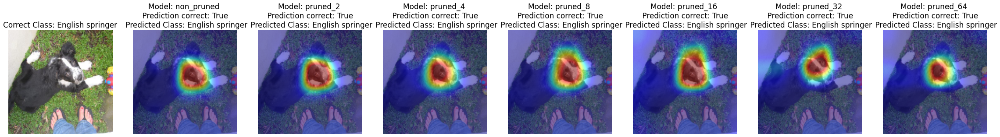

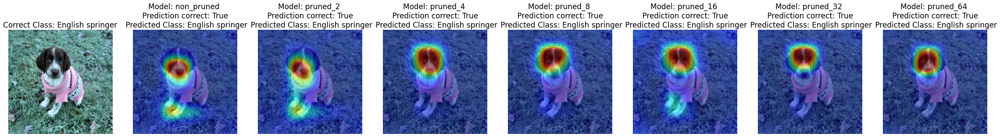

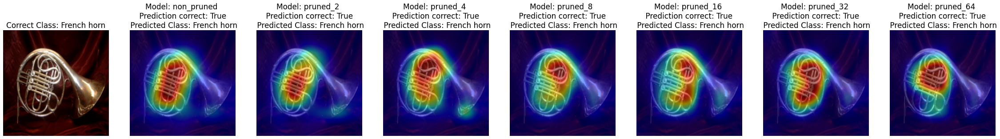

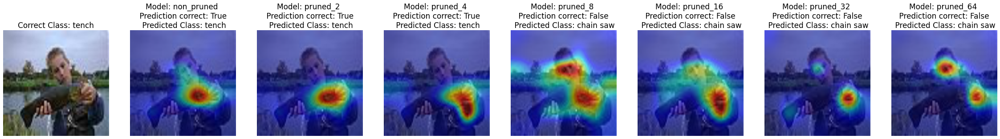

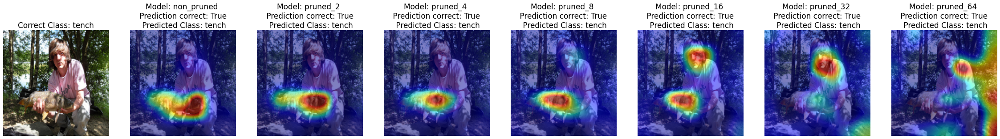

...

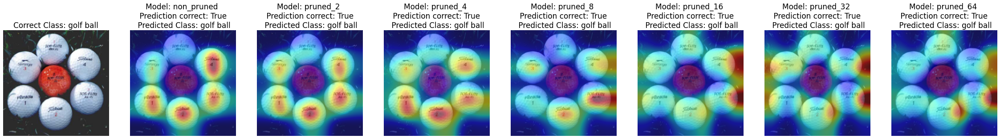

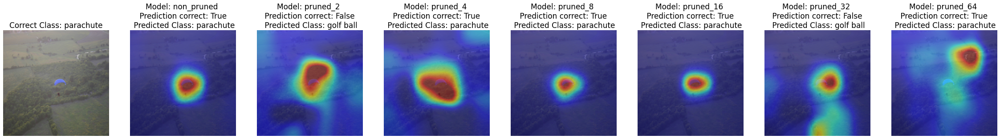

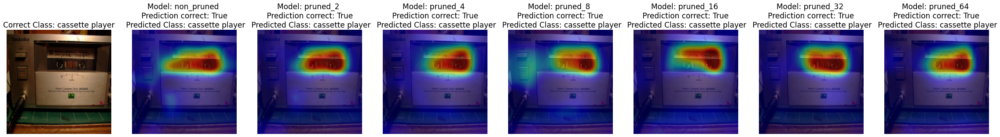

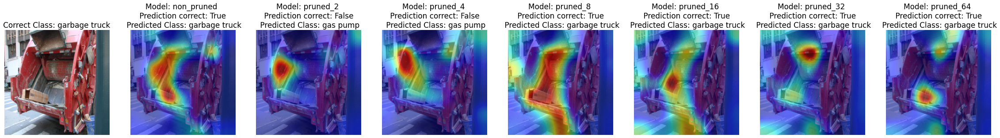

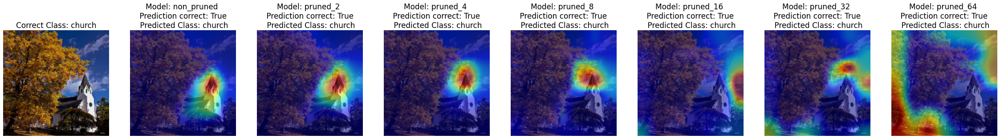

In [39]:
### FOR LMU ONLY
for i in range(30):      # plotting the first X images that were correctly predicted
    # If non-pruned model prediction is false, do not show Image
    pred = non_pruned(imgs[i].unsqueeze(0))
    
    if lbls[i] == pred.squeeze(0).argmax():
        fig, axes = plt.subplots(nrows=1, ncols=8, figsize=(40, 40))
        axes[0].set_title('Correct Class: {}'.format(classes[lbls[i]]), size=17)
        axes[0].imshow(transforms.ToPILImage()(imgs[i]))
        axes[0].axis('off')
        
        col = 1
        for name, model in models_dict.items():
            cam = GradCAM(model)
            pred = model(imgs[i].unsqueeze(0))

            activation_map = cam(pred.squeeze(0).argmax().item(), pred)
            result = overlay_mask(to_pil_image(imgs[i]), to_pil_image(activation_map, mode='F'), alpha=0.5)

            # Plot it
            axes[col].set_title('Model: {} \n Prediction correct: {} \n Predicted Class: {}'.format(name, lbls[i] == pred.squeeze(0).argmax(),
                                                                                                         classes[pred.squeeze(0).argmax()]), size = 17)
            axes[col].imshow(result)
            axes[col].axis('off')
            col += 1
        plt.show() # plot every subplot

In [ ]:
### FOR LMU AND LRU
for i in range(50):      # plotting the first X images that were correctly predicted
    # If non-pruned model prediction is false, do not show Image
    pred = non_pruned(imgs[i].unsqueeze(0))
    
    if lbls[i] == pred.squeeze(0).argmax():
        fig, axes = plt.subplots(nrows=2, ncols=8, figsize=(50, 15))
        axes[0, 0].set_title('Correct Class: {}'.format(classes[vlbls[i]]), size=20)
        axes[0, 0].imshow(transforms.ToPILImage()(vimgs[i]))
        axes[0, 0].axis('off')
        axes[1, 0].set_title('Correct Class: {}'.format(classes[vlbls[i]]), size=20)
        axes[1, 0].imshow(transforms.ToPILImage()(vimgs[i]))
        axes[1, 0].axis('off')
        col = 1
        
        for name, models in models_dict.items():
            row = 0
            
            for model in models:
                cam = GradCAM(model)
                pred = model(imgs[i].unsqueeze(0))

                activation_map = cam(pred.squeeze(0).argmax().item(), pred)
                result = overlay_mask(to_pil_image(vimgs[i]), to_pil_image(activation_map, mode='F'), alpha=0.5)

                # Plot it
                axes[row, col].set_title('Model: {} \n Prediction correct: {} \n Predicted Class: {}'.format(name, lbls[i] == pred.squeeze(0).argmax(),
                                                                                                             classes[pred.squeeze(0).argmax()]), size = 20)
                axes[row, col].imshow(result)
                axes[row, col].axis('off')
                row += 1
            col += 1
        plt.show() # plot every subplot